In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns 
from sklearn.model_selection import train_test_split

In [2]:
df=pd.read_csv(R'F:\job\customer segmentation\customer_segmentation.csv',index_col=0)

In [3]:
df.head()

,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
ID,,,,,,,,,,,,,,,,,,,,,
5524,1957,Graduation,Single,58138.0,0,0,04-09-2012,58,635,88,...,7,0,0,0,0,0,0,3,11,1
2174,1954,Graduation,Single,46344.0,1,1,08-03-2014,38,11,1,...,5,0,0,0,0,0,0,3,11,0
4141,1965,Graduation,Together,71613.0,0,0,21-08-2013,26,426,49,...,4,0,0,0,0,0,0,3,11,0
6182,1984,Graduation,Together,26646.0,1,0,10-02-2014,26,11,4,...,6,0,0,0,0,0,0,3,11,0
5324,1981,PhD,Married,58293.0,1,0,19-01-2014,94,173,43,...,5,0,0,0,0,0,0,3,11,0


In [4]:
df.shape

(2240, 28)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2240 entries, 5524 to 9405
Data columns (total 28 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Year_Birth           2240 non-null   int64  
 1   Education            2240 non-null   object 
 2   Marital_Status       2240 non-null   object 
 3   Income               2216 non-null   float64
 4   Kidhome              2240 non-null   int64  
 5   Teenhome             2240 non-null   int64  
 6   Dt_Customer          2240 non-null   object 
 7   Recency              2240 non-null   int64  
 8   MntWines             2240 non-null   int64  
 9   MntFruits            2240 non-null   int64  
 10  MntMeatProducts      2240 non-null   int64  
 11  MntFishProducts      2240 non-null   int64  
 12  MntSweetProducts     2240 non-null   int64  
 13  MntGoldProds         2240 non-null   int64  
 14  NumDealsPurchases    2240 non-null   int64  
 15  NumWebPurchases      2240 non-null 

In [6]:
df.describe()

,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
count,2240.000000,2216.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,...,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.0,2240.0,2240.000000
mean,1968.805804,52247.251354,0.444196,0.506250,49.109375,303.935714,26.302232,166.950000,37.525446,27.062946,...,5.316518,0.072768,0.074554,0.072768,0.064286,0.013393,0.009375,3.0,11.0,0.149107
std,11.984069,25173.076661,0.538398,0.544538,28.962453,336.597393,39.773434,225.715373,54.628979,41.280498,...,2.426645,0.259813,0.262728,0.259813,0.245316,0.114976,0.096391,0.0,0.0,0.356274
min,1893.000000,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
25%,1959.000000,35303.000000,0.000000,0.000000,24.000000,23.750000,1.000000,16.000000,3.000000,1.000000,...,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
50%,1970.000000,51381.500000,0.000000,0.000000,49.000000,173.500000,8.000000,67.000000,12.000000,8.000000,...,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
75%,1977.000000,68522.000000,1.000000,1.000000,74.000000,504.250000,33.000000,232.000000,50.000000,33.000000,...,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
max,1996.000000,666666.000000,2.000000,2.000000,99.000000,1493.000000,199.000000,1725.000000,259.000000,263.000000,...,20.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,3.0,11.0,1.000000


In [7]:
df.isnull().sum()

Year_Birth              0
Education               0
Marital_Status          0
Income                 24
Kidhome                 0
Teenhome                0
Dt_Customer             0
Recency                 0
MntWines                0
MntFruits               0
MntMeatProducts         0
MntFishProducts         0
MntSweetProducts        0
MntGoldProds            0
NumDealsPurchases       0
NumWebPurchases         0
NumCatalogPurchases     0
NumStorePurchases       0
NumWebVisitsMonth       0
AcceptedCmp3            0
AcceptedCmp4            0
AcceptedCmp5            0
AcceptedCmp1            0
AcceptedCmp2            0
Complain                0
Z_CostContact           0
Z_Revenue               0
Response                0
dtype: int64

In [8]:
df['Income'].fillna(df['Income'].median(),inplace=True)
df.isnull().sum()

Year_Birth             0
Education              0
Marital_Status         0
Income                 0
Kidhome                0
Teenhome               0
Dt_Customer            0
Recency                0
MntWines               0
MntFruits              0
MntMeatProducts        0
MntFishProducts        0
MntSweetProducts       0
MntGoldProds           0
NumDealsPurchases      0
NumWebPurchases        0
NumCatalogPurchases    0
NumStorePurchases      0
NumWebVisitsMonth      0
AcceptedCmp3           0
AcceptedCmp4           0
AcceptedCmp5           0
AcceptedCmp1           0
AcceptedCmp2           0
Complain               0
Z_CostContact          0
Z_Revenue              0
Response               0
dtype: int64

In [9]:
educationCategories=df['Education'].value_counts()
print('Total categories in the feature Education:\n',educationCategories)

Total categories in the feature Education:
 Graduation    1127
PhD            486
Master         370
2n Cycle       203
Basic           54
Name: Education, dtype: int64


In [10]:
martialStatusCategories=df['Marital_Status'].value_counts()
print('Total categories in the feature Marital_Status:\n',martialStatusCategories)

Total categories in the feature Marital_Status:
 Married     864
Together    580
Single      480
Divorced    232
Widow        77
Alone         3
Absurd        2
YOLO          2
Name: Marital_Status, dtype: int64


In [11]:
df['Dt_Customer']=pd.to_datetime(df['Dt_Customer'],format='%d-%m-%Y')
print('The newest customers enrolment date in the records',df['Dt_Customer'].max())
print('The oldest customers enrolment date in the records',df['Dt_Customer'].min())

The newest customers enrolment date in the records 2014-06-29 00:00:00
The oldest customers enrolment date in the records 2012-07-30 00:00:00


In [12]:
df['customerAge']=2014-df['Year_Birth']

In [13]:
df['Children'] = df['Kidhome'] + df['Teenhome']

In [14]:
df['Spent'] = df['MntWines'] + df['MntFruits'] + df['MntMeatProducts'] + df['MntFishProducts'] + df['MntSweetProducts'] + df['MntGoldProds']

In [15]:
def convertMartialStatus(martialStatus):
    if martialStatus in ['Married','Together']:
        return 'together'
    else:
        return 'alone'

df['Living_with']=df['Marital_Status'].apply(convertMartialStatus)


In [16]:
df['familySize']=df['Living_with'].replace({'alone':1,'together':2})+df['Children']

In [17]:
df['isParent'] = np.where(df['Children'] > 0, 1, 0)

In [18]:
def Education(EducationStatus):
    if EducationStatus in ['Basic','2n Cycle']:
        return 'Undergraduate'
    elif EducationStatus in ['Graduation']:
        return 'Graduate'
    elif EducationStatus in ['Master','PhD']:
        return 'Postgraduate'

df['Education']=df['Education'].apply(Education)

In [19]:
df.columns

Index(['Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Dt_Customer', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Z_CostContact', 'Z_Revenue', 'Response',
       'customerAge', 'Children', 'Spent', 'Living_with', 'familySize',
       'isParent'],
      dtype='object')

In [20]:
df=df.drop(columns=['Year_Birth','Marital_Status','Z_CostContact','Z_Revenue','Dt_Customer'],axis=1)

In [21]:
df.describe()

,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,...,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,customerAge,Children,Spent,familySize,isParent
count,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,...,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000
mean,52237.975446,0.444196,0.506250,49.109375,303.935714,26.302232,166.950000,37.525446,27.062946,44.021875,...,0.072768,0.064286,0.013393,0.009375,0.149107,45.194196,0.950446,605.798214,2.595089,0.715179
std,25037.955891,0.538398,0.544538,28.962453,336.597393,39.773434,225.715373,54.628979,41.280498,52.167439,...,0.259813,0.245316,0.114976,0.096391,0.356274,11.984069,0.751803,602.249288,0.906959,0.451430
min,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,18.000000,0.000000,5.000000,1.000000,0.000000
25%,35538.750000,0.000000,0.000000,24.000000,23.750000,1.000000,16.000000,3.000000,1.000000,9.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,37.000000,0.000000,68.750000,2.000000,0.000000
50%,51381.500000,0.000000,0.000000,49.000000,173.500000,8.000000,67.000000,12.000000,8.000000,24.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,44.000000,1.000000,396.000000,3.000000,1.000000
75%,68289.750000,1.000000,1.000000,74.000000,504.250000,33.000000,232.000000,50.000000,33.000000,56.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,55.000000,1.000000,1045.500000,3.000000,1.000000
max,666666.000000,2.000000,2.000000,99.000000,1493.000000,199.000000,1725.000000,259.000000,263.000000,362.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,121.000000,3.000000,2525.000000,5.000000,1.000000


In [22]:
# there are few outliers in the 'customerAge' feature
df = df[(df["customerAge"]<100)]

In [23]:
print('The total number of data-points after removing the outliers are:',len(df))
df.columns

The total number of data-points after removing the outliers are: 2237


Index(['Education', 'Income', 'Kidhome', 'Teenhome', 'Recency', 'MntWines',
       'MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Response', 'customerAge', 'Children',
       'Spent', 'Living_with', 'familySize', 'isParent'],
      dtype='object')

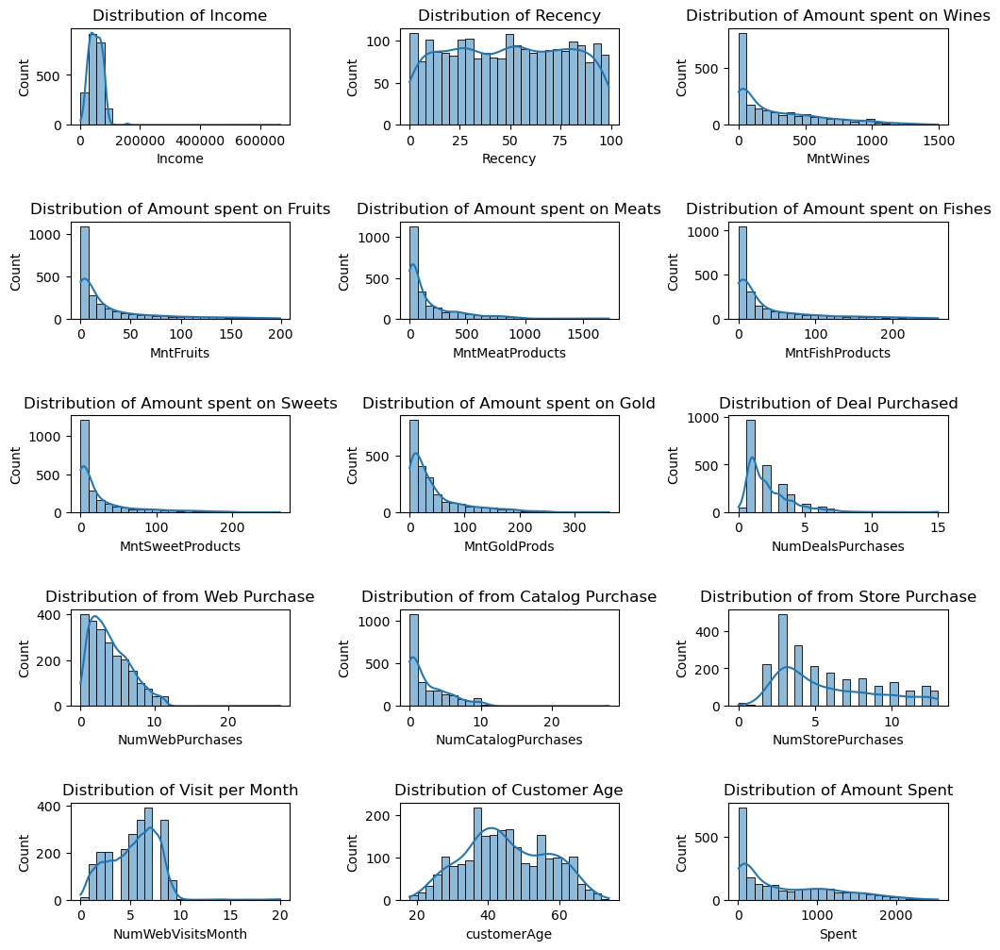

In [24]:
plt.figure(figsize=(12,12))
plt.subplots_adjust(hspace = 1, wspace=0.5)
plt.subplot(5,3,1)
sns.histplot(data=df,x='Income',kde=True,bins=25)
plt.title("Distribution of Income")

plt.subplot(5,3,2)
sns.histplot(data=df,x='Recency',kde=True,bins=25)
plt.title("Distribution of Recency")

plt.subplot(5,3,3)
sns.histplot(data=df,x='MntWines',kde=True,bins=25)
plt.title("Distribution of Amount spent on Wines")

plt.subplot(5,3,4)
sns.histplot(data=df,x='MntFruits',kde=True,bins=25)
plt.title("Distribution of Amount spent on Fruits")

plt.subplot(5,3,5)
sns.histplot(data=df,x='MntMeatProducts',kde=True,bins=25)
plt.title("Distribution of Amount spent on Meats")

plt.subplot(5,3,6)
sns.histplot(data=df,x='MntFishProducts',kde=True,bins=25)
plt.title("Distribution of Amount spent on Fishes")

plt.subplot(5,3,7)
sns.histplot(data=df,x='MntSweetProducts',kde=True,bins=25)
plt.title("Distribution of Amount spent on Sweets")

plt.subplot(5,3,8)
sns.histplot(data=df,x='MntGoldProds',kde=True,bins=25)
plt.title("Distribution of Amount spent on Gold")

plt.subplot(5,3,9)
sns.histplot(data=df,x='NumDealsPurchases',kde=True,bins=25)
plt.title("Distribution of Deal Purchased")

plt.subplot(5,3,10)
sns.histplot(data=df,x='NumWebPurchases',kde=True,bins=25)
plt.title("Distribution of from Web Purchase")

plt.subplot(5,3,11)
sns.histplot(data=df,x='NumCatalogPurchases',kde=True,bins=25)
plt.title("Distribution of from Catalog Purchase")

plt.subplot(5,3,12)
sns.histplot(data=df,x='NumStorePurchases',kde=True,bins=25)
plt.title("Distribution of from Store Purchase")

plt.subplot(5,3,13)
sns.histplot(data=df,x='NumWebVisitsMonth',kde=True,bins=25)
plt.title("Distribution of Visit per Month")

plt.subplot(5,3,14)
sns.histplot(data=df,x='customerAge',kde=True,bins=25)
plt.title("Distribution of Customer Age")

plt.subplot(5,3,15)
sns.histplot(data=df,x='Spent',kde=True,bins=25)
plt.title("Distribution of Amount Spent")
plt.show()

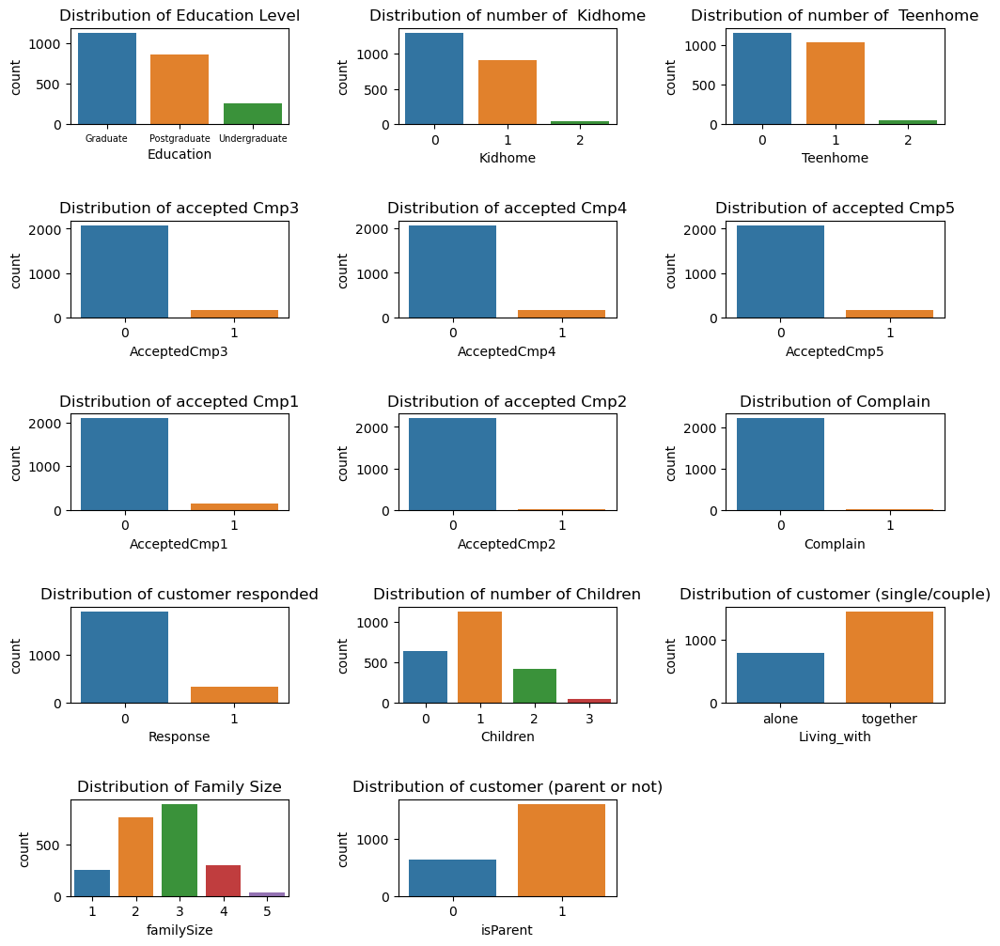

In [25]:
plt.figure(figsize=(12,12))
plt.subplots_adjust(hspace = 1, wspace=0.5)
plt.subplot(5,3,1)
sns.countplot(data=df,x='Education')
plt.tick_params(axis='x', labelsize=7)
plt.title("Distribution of Education Level")

plt.subplot(5,3,2)
sns.countplot(data=df,x='Kidhome')
plt.title("Distribution of number of  Kidhome")

plt.subplot(5,3,3)
sns.countplot(data=df,x='Teenhome')
plt.title("Distribution of number of  Teenhome")

plt.subplot(5,3,4)
sns.countplot(data=df,x='AcceptedCmp3')
plt.title("Distribution of accepted Cmp3")

plt.subplot(5,3,5)
sns.countplot(data=df,x='AcceptedCmp4')
plt.title("Distribution of accepted Cmp4")

plt.subplot(5,3,6)
sns.countplot(data=df,x='AcceptedCmp5')
plt.title("Distribution of accepted Cmp5")

plt.subplot(5,3,7)
sns.countplot(data=df,x='AcceptedCmp1')
plt.title("Distribution of accepted Cmp1")

plt.subplot(5,3,8)
sns.countplot(data=df,x='AcceptedCmp2')
plt.title("Distribution of accepted Cmp2")

plt.subplot(5,3,9)
sns.countplot(data=df,x='Complain')
plt.title("Distribution of Complain")

plt.subplot(5,3,10)
sns.countplot(data=df,x='Response')
plt.title("Distribution of customer responded")

plt.subplot(5,3,11)
sns.countplot(data=df,x='Children')
plt.title("Distribution of number of Children")

plt.subplot(5,3,12)
sns.countplot(data=df,x='Living_with')
plt.title("Distribution of customer (single/couple)")

plt.subplot(5,3,13)
sns.countplot(data=df,x='familySize')
plt.title("Distribution of Family Size")

plt.subplot(5,3,14)
sns.countplot(data=df,x='isParent')
plt.title("Distribution of customer (parent or not)")


plt.show()

<Figure size 5000x5000 with 0 Axes>

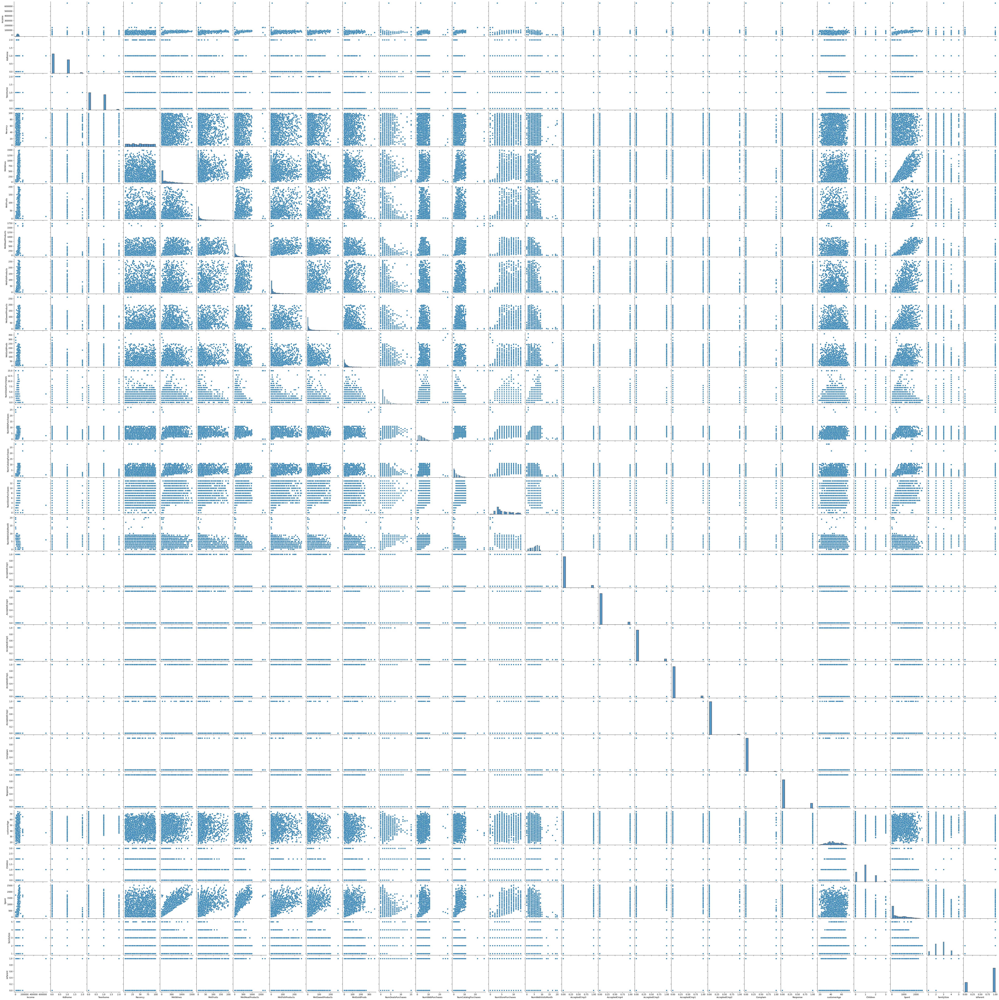

In [26]:
plt.figure(figsize=(50,50))
sns.pairplot(data=df)
plt.show()

In [27]:
df.dtypes

Education               object
Income                 float64
Kidhome                  int64
Teenhome                 int64
Recency                  int64
MntWines                 int64
MntFruits                int64
MntMeatProducts          int64
MntFishProducts          int64
MntSweetProducts         int64
MntGoldProds             int64
NumDealsPurchases        int64
NumWebPurchases          int64
NumCatalogPurchases      int64
NumStorePurchases        int64
NumWebVisitsMonth        int64
AcceptedCmp3             int64
AcceptedCmp4             int64
AcceptedCmp5             int64
AcceptedCmp1             int64
AcceptedCmp2             int64
Complain                 int64
Response                 int64
customerAge              int64
Children                 int64
Spent                    int64
Living_with             object
familySize               int64
isParent                 int32
dtype: object

In [28]:
numericalFeatures=df.select_dtypes('number').columns.to_list()
categoricalFeatures=df.select_dtypes('object').columns.to_list()
print(f"Numerical Features  : {numericalFeatures}")
print(f"Categorical Features: {categoricalFeatures}")

Numerical Features  : ['Income', 'Kidhome', 'Teenhome', 'Recency', 'MntWines', 'MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts', 'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases', 'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1', 'AcceptedCmp2', 'Complain', 'Response', 'customerAge', 'Children', 'Spent', 'familySize', 'isParent']
Categorical Features: ['Education', 'Living_with']


In [29]:
from sklearn.preprocessing import StandardScaler, LabelEncoder
LE = LabelEncoder()
for i in categoricalFeatures:
  df[i] = df[[i]].apply(LE.fit_transform)

In [30]:
scaler=StandardScaler()
scaledData=scaler.fit_transform(df)
scaledData=pd.DataFrame(scaledData,columns=df.columns)

In [31]:
scaledData.head()

,Education,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,...,AcceptedCmp1,AcceptedCmp2,Complain,Response,customerAge,Children,Spent,Living_with,familySize,isParent
0,-0.894021,0.236068,-0.825388,-0.930227,0.307272,0.983671,1.554623,1.680253,2.461700,1.475877,...,-0.262299,-0.11659,-0.09498,2.386966,1.017296,-1.264618,1.680649,-1.348103,-1.759324,-1.584858
1,-0.894021,-0.234982,1.032151,0.906417,-0.383584,-0.870717,-0.636422,-0.713250,-0.650275,-0.631440,...,-0.262299,-0.11659,-0.09498,-0.418942,1.273722,1.395420,-0.961838,-1.348103,0.445498,0.630971
2,-0.894021,0.774257,-0.825388,-0.930227,-0.798098,0.362570,0.572430,-0.176928,1.345050,-0.147000,...,-0.262299,-0.11659,-0.09498,-0.418942,0.333495,-1.264618,0.282956,0.741783,-0.656913,-1.584858
3,-0.894021,-1.021717,1.032151,-0.930227,-0.798098,-0.870717,-0.560868,-0.651196,-0.503829,-0.582996,...,-0.262299,-0.11659,-0.09498,-0.418942,-1.290534,0.065401,-0.918627,0.741783,0.445498,0.630971
4,0.571125,0.242259,1.032151,-0.930227,1.550812,-0.389289,0.421324,-0.216820,0.155177,-0.001667,...,-0.262299,-0.11659,-0.09498,-0.418942,-1.034108,0.065401,-0.305371,0.741783,0.445498,0.630971


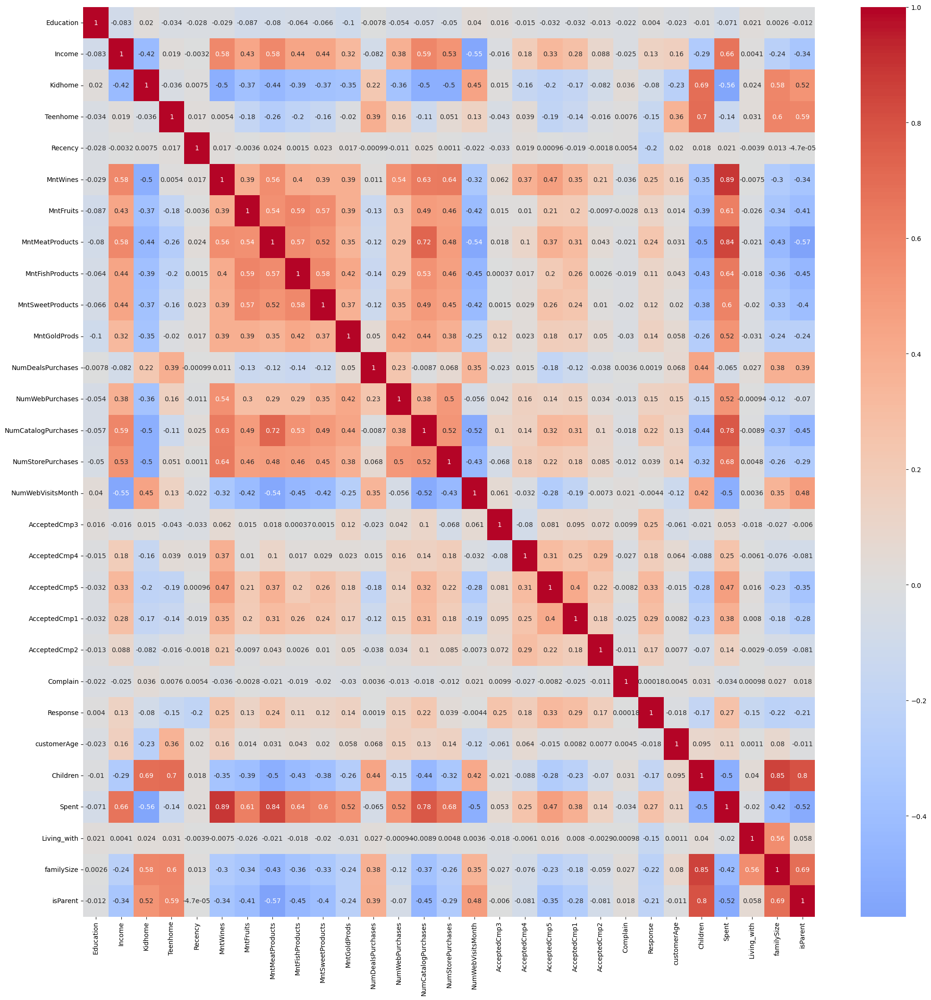

In [32]:
correlation=scaledData.corr()
plt.figure(figsize=(25,25))
sns.heatmap(data=correlation,annot=True,cmap='coolwarm',center=0)
plt.show()

In [33]:
from sklearn.decomposition import PCA

scaledData2=scaledData.copy()
pca = PCA(random_state = 42, svd_solver = 'full')
pca.fit(scaledData2)
cumsum = np.cumsum(pca.explained_variance_ratio_)
d = np.argmax(cumsum >= 0.95) + 1
print(d)

21


In [34]:
cumsum

array([0.29508368, 0.39487257, 0.46062499, 0.51015327, 0.55781868,
       0.59572394, 0.63273499, 0.66717974, 0.70138411, 0.73412321,
       0.76226862, 0.78852933, 0.81317108, 0.83431088, 0.85517954,
       0.87468515, 0.89245565, 0.90901155, 0.92464314, 0.93939344,
       0.95298908, 0.96555746, 0.97634656, 0.98560598, 0.99311281,
       1.        , 1.        , 1.        , 1.        ])

In [35]:
pca = PCA(n_components = 20, random_state = 42, svd_solver = 'full')
pca.fit(scaledData2)
df1_reduced = pd.DataFrame(pca.transform(scaledData2), columns = (['col1', 'col2', 'col3', 'col4',
                                                                  'col5', 'col6', 'col7', 'col8',
                                                                  'col9', 'col10', 'col11', 'col12',
                                                                  'col13', 'col14', 'col15', 'col16',
                                                                  'col17', 'col18', 'col19', 'col20']))

In [36]:
!pip install yellowbrick

Defaulting to user installation because normal site-packages is not writeable


Elbow Method to determine the number of clusters to be formed:


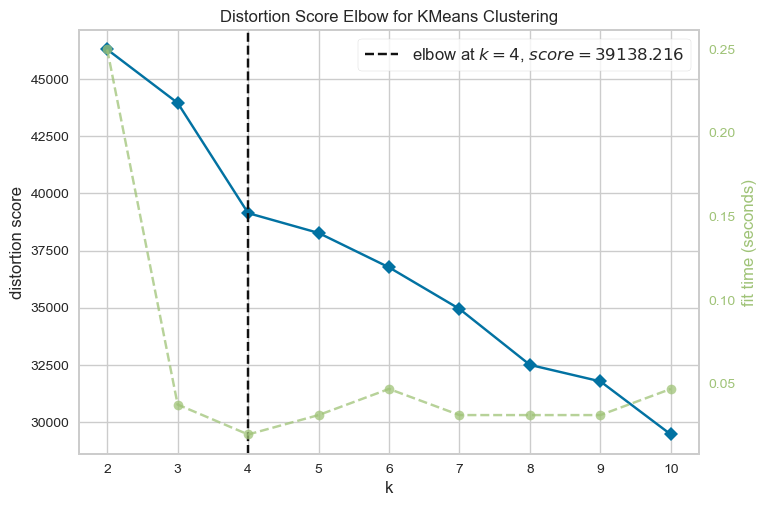

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [37]:
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans

print("Elbow Method to determine the number of clusters to be formed:")
elbow = KElbowVisualizer(KMeans(), k = 10)
elbow.fit(df1_reduced)
elbow.show()

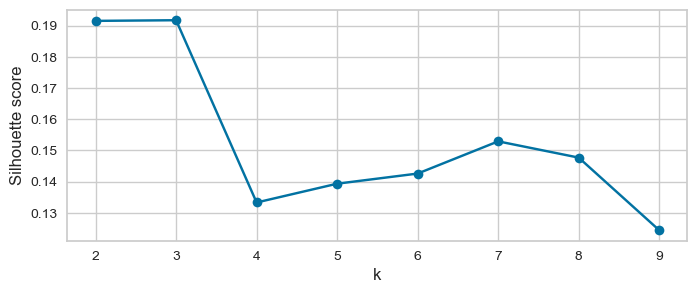

In [44]:
from sklearn.metrics import silhouette_score

kmeans_per_k = [KMeans(n_clusters=k, n_init=10, random_state=42).fit(df1_reduced)
                for k in range(2, 11)]

silhouette_scores = [silhouette_score(df1_reduced, model.labels_)
                     for model in kmeans_per_k[1:]]

plt.figure(figsize=(8, 3))
plt.plot(range(2, 10), silhouette_scores, "bo-")
plt.xlabel("k")
plt.ylabel("Silhouette score")

plt.grid(True)

plt.show()

In [45]:
for k, silhouette_score in zip(range(2, 11), silhouette_scores):
    print(f"For k = {k}, silhouette score = {silhouette_score}")


For k = 2, silhouette score = 0.19152067094300917
For k = 3, silhouette score = 0.19172869655203922
For k = 4, silhouette score = 0.1333422710140031
For k = 5, silhouette score = 0.13936398249679555
For k = 6, silhouette score = 0.14261108543372747
For k = 7, silhouette score = 0.15292604230317827
For k = 8, silhouette score = 0.1477164404757456
For k = 9, silhouette score = 0.12445923776866578


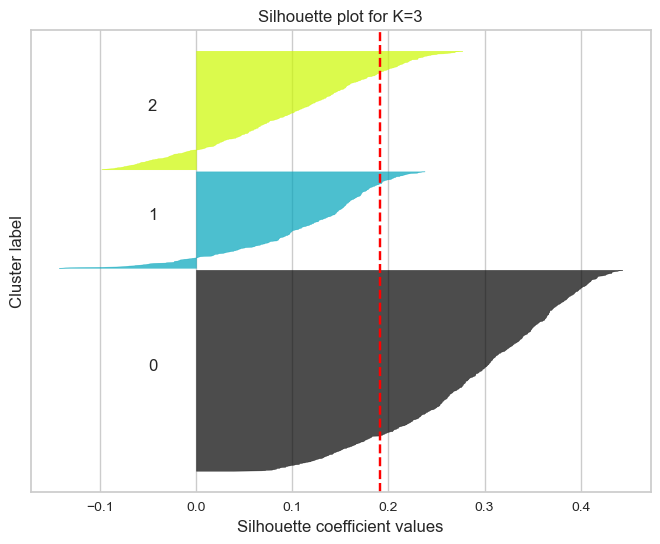

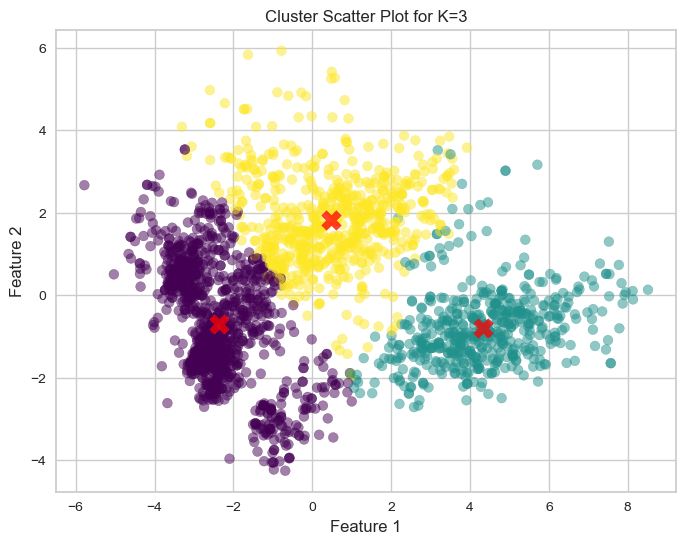

In [52]:
from sklearn.metrics import silhouette_samples


kmeans = KMeans(n_clusters=3, n_init=10, random_state=42)
kmeans.fit(df1_reduced)


cluster_labels = kmeans.labels_

silhouette_scores = silhouette_samples(df1_reduced, cluster_labels)


plt.figure(figsize=(8, 6))
y_lower = 10
for i in range(3):
    
    ith_cluster_silhouette_values = \
        silhouette_scores[cluster_labels == i]

    ith_cluster_silhouette_values.sort()

    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    color = plt.cm.nipy_spectral(float(i) / 3)
    plt.fill_betweenx(np.arange(y_lower, y_upper),
                      0, ith_cluster_silhouette_values,
                      facecolor=color, edgecolor=color, alpha=0.7)

  
    plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))


    y_lower = y_upper + 10  

plt.title("Silhouette plot for K=3")
plt.xlabel("Silhouette coefficient values")
plt.ylabel("Cluster label")


plt.axvline(x=np.mean(silhouette_scores), color="red", linestyle="--")


plt.yticks([])  
plt.show()

plt.figure(figsize=(8, 6))


x = df1_reduced.iloc[:, 0]

y = df1_reduced.iloc[:, 1]

plt.scatter(x, y, c=cluster_labels, cmap='viridis', s=50, alpha=0.5)


centers = kmeans.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], c='red', s=200, alpha=0.75, marker='X')

plt.title("Cluster Scatter Plot for K=3")
plt.xlabel("Feature 1")
plt.ylabel("Feature 2")
plt.show()



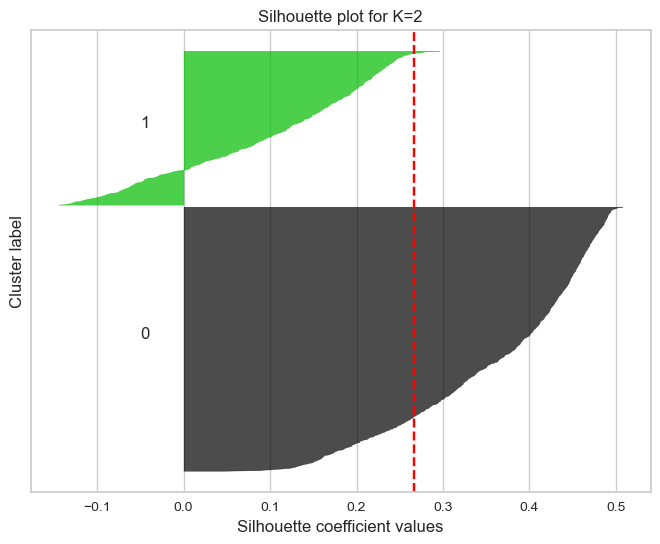

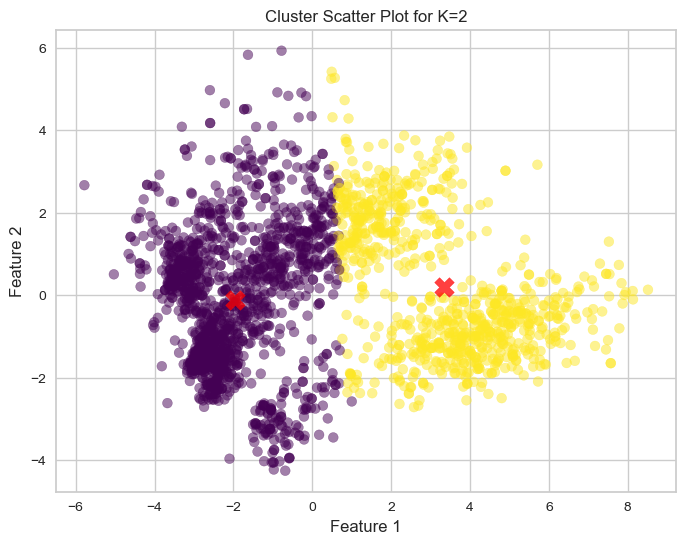

In [53]:
kmeans = KMeans(n_clusters=2, n_init=10, random_state=42)
kmeans.fit(df1_reduced)

cluster_labels = kmeans.labels_

silhouette_scores = silhouette_samples(df1_reduced, cluster_labels)

plt.figure(figsize=(8, 6))
y_lower = 10
for i in range(2):
    
    ith_cluster_silhouette_values = silhouette_scores[cluster_labels == i]
    ith_cluster_silhouette_values.sort()
    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    color = plt.cm.nipy_spectral(float(i) / 2)
    plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values,
                      facecolor=color, edgecolor=color, alpha=0.7)
    plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
    y_lower = y_upper + 10  

plt.title("Silhouette plot for K=2")
plt.xlabel("Silhouette coefficient values")
plt.ylabel("Cluster label")
plt.axvline(x=np.mean(silhouette_scores), color="red", linestyle="--")
plt.yticks([])  
plt.show()

plt.figure(figsize=(8, 6))


x = df1_reduced.iloc[:, 0]

y = df1_reduced.iloc[:, 1]

plt.scatter(x, y, c=cluster_labels, cmap='viridis', s=50, alpha=0.5)


centers = kmeans.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], c='red', s=200, alpha=0.75, marker='X')

plt.title("Cluster Scatter Plot for K=2")
plt.xlabel("Feature 1")
plt.ylabel("Feature 2")
plt.show()

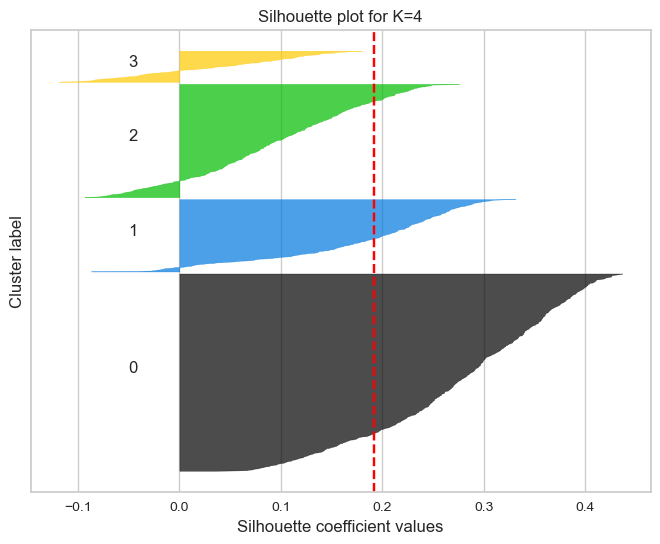

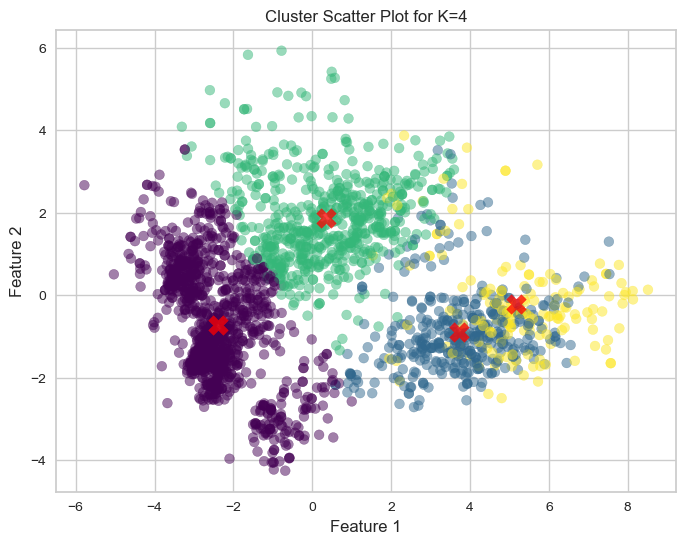

In [54]:
kmeans = KMeans(n_clusters=4, n_init=10, random_state=42)
kmeans.fit(df1_reduced)

cluster_labels = kmeans.labels_

silhouette_scores = silhouette_samples(df1_reduced, cluster_labels)

plt.figure(figsize=(8, 6))
y_lower = 10
for i in range(4):
    
    ith_cluster_silhouette_values = silhouette_scores[cluster_labels == i]
    ith_cluster_silhouette_values.sort()
    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    color = plt.cm.nipy_spectral(float(i) / 4)
    plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values,
                      facecolor=color, edgecolor=color, alpha=0.7)
    plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
    y_lower = y_upper + 10  

plt.title("Silhouette plot for K=4")
plt.xlabel("Silhouette coefficient values")
plt.ylabel("Cluster label")
plt.axvline(x=np.mean(silhouette_scores), color="red", linestyle="--")
plt.yticks([])  
plt.show()

plt.figure(figsize=(8, 6))


x = df1_reduced.iloc[:, 0]

y = df1_reduced.iloc[:, 1]

plt.scatter(x, y, c=cluster_labels, cmap='viridis', s=50, alpha=0.5)


centers = kmeans.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], c='red', s=200, alpha=0.75, marker='X')

plt.title("Cluster Scatter Plot for K=4")
plt.xlabel("Feature 1")
plt.ylabel("Feature 2")
plt.show()

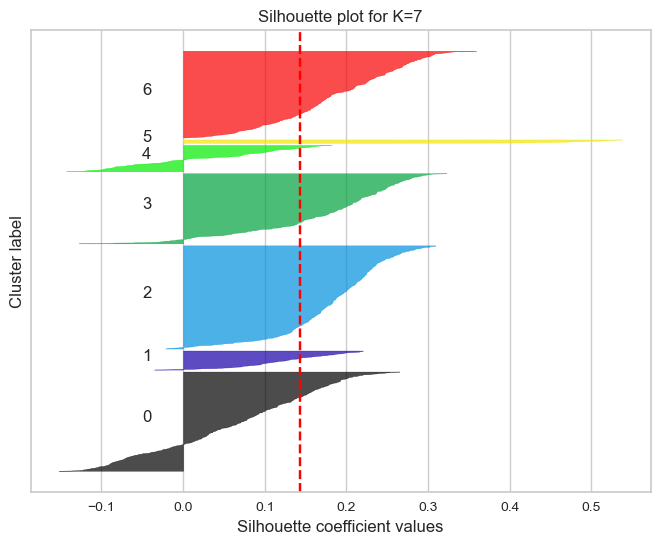

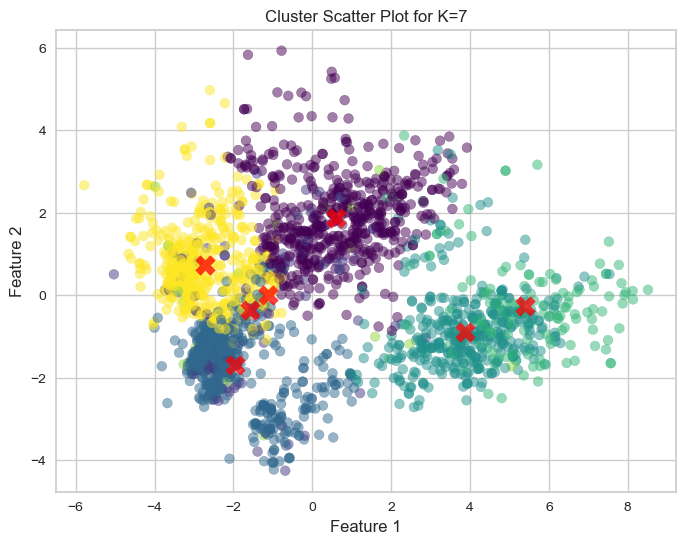

In [55]:
kmeans = KMeans(n_clusters=7, n_init=10, random_state=42)
kmeans.fit(df1_reduced)

cluster_labels = kmeans.labels_

silhouette_scores = silhouette_samples(df1_reduced, cluster_labels)

plt.figure(figsize=(8, 6))
y_lower = 10
for i in range(7):
    
    ith_cluster_silhouette_values = silhouette_scores[cluster_labels == i]
    ith_cluster_silhouette_values.sort()
    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    color = plt.cm.nipy_spectral(float(i) / 7)
    plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values,
                      facecolor=color, edgecolor=color, alpha=0.7)
    plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
    y_lower = y_upper + 10  

plt.title("Silhouette plot for K=7")
plt.xlabel("Silhouette coefficient values")
plt.ylabel("Cluster label")
plt.axvline(x=np.mean(silhouette_scores), color="red", linestyle="--")
plt.yticks([])  
plt.show()

plt.figure(figsize=(8, 6))


x = df1_reduced.iloc[:, 0]

y = df1_reduced.iloc[:, 1]

plt.scatter(x, y, c=cluster_labels, cmap='viridis', s=50, alpha=0.5)


centers = kmeans.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], c='red', s=200, alpha=0.75, marker='X')

plt.title("Cluster Scatter Plot for K=7")
plt.xlabel("Feature 1")
plt.ylabel("Feature 2")
plt.show()

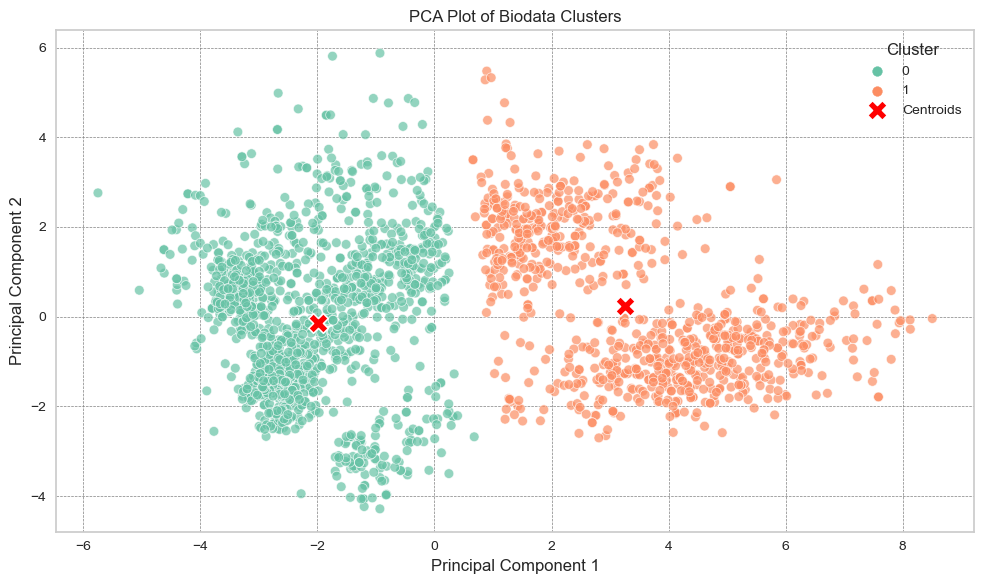

In [76]:
kmeans = KMeans(n_clusters= 2, random_state=42)  #change value of n_clusters
cluster_labels = kmeans.fit_predict(df1_reduced)
df['Cluster'] = cluster_labels
df.to_excel('Clustered_data.xlsx', index = False)


df2 = pd.read_excel('Clustered_data.xlsx')

scaler1 = StandardScaler()
normalized_data = scaler1.fit_transform(df2)

pca = PCA(n_components=2)
pca_data = pca.fit_transform(normalized_data)

df2['PC1'] = pca_data[:, 0]
df2['PC2'] = pca_data[:, 1]


cluster_palette = sns.color_palette("Set2", n_colors = 2)

plt.figure(figsize = (10, 6))

sns.scatterplot(df2, x = 'PC1', y = 'PC2', hue = 'Cluster', palette = cluster_palette, alpha = 0.7)

plt.title("PCA Plot of Biodata Clusters")
plt.xlabel("Principal Component 1")
plt.ylabel("Principal Component 2")

plt.grid(True)
plt.tight_layout()



plt.grid(color='gray', linestyle='--', linewidth=0.5)

sns.scatterplot(x = kmeans.cluster_centers_[:,0], y = kmeans.cluster_centers_[:,1], marker = 'X', s = 200, color = 'red', label = 'Centroids')
plt.legend(title = 'Cluster')


plt.show()

In [77]:
df.head()

,Education,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,...,AcceptedCmp2,Complain,Response,customerAge,Children,Spent,Living_with,familySize,isParent,Cluster
ID,,,,,,,,,,,,,,,,,,,,,
5524,0,58138.0,0,0,58,635,88,546,172,88,...,0,0,1,57,0,1617,0,1,0,1
2174,0,46344.0,1,1,38,11,1,6,2,1,...,0,0,0,60,2,27,0,3,1,0
4141,0,71613.0,0,0,26,426,49,127,111,21,...,0,0,0,49,0,776,1,2,0,1
6182,0,26646.0,1,0,26,11,4,20,10,3,...,0,0,0,30,1,53,1,3,1,0
5324,1,58293.0,1,0,94,173,43,118,46,27,...,0,0,0,33,1,422,1,3,1,0


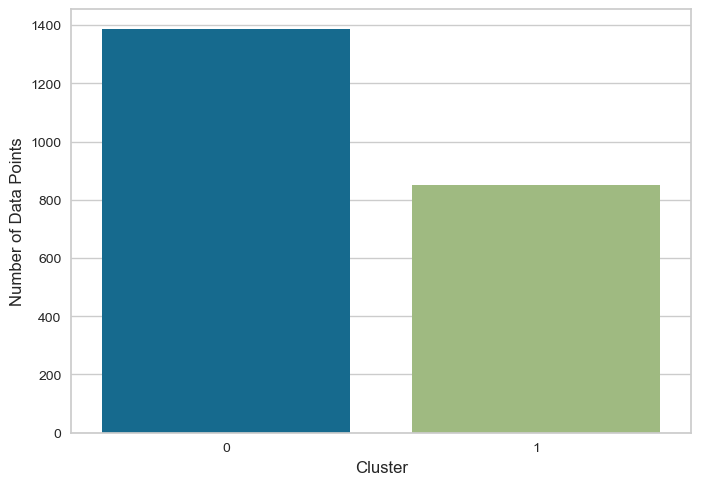

In [83]:
sns.countplot(data=df,x='Cluster')
plt.xlabel('Cluster')
plt.ylabel('Number of Data Points')
plt.show()


In [85]:
sns.pairplot(data=df,hue='Cluster')